Github Link: [here](https://github.com/yafanyayy/eng_sci_143_final_project/tree/main)

In [1]:
# Mount your google drive. This will launch a pop-up window for authentication.

# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
# %cd "/content/drive/My Drive/es-143-assignments/ES_143_Final_Project/"

# Camera Calibration


## Install libraries


In [3]:
%pip install opencv-python pupil-apriltags pillow-heif



In [4]:
# Import any required libraries here
import cv2                               # OpenCV
import numpy as np                       # numpy
import os
from pupil_apriltags import Detector
import requests
import pickle
import glob   # filename and path management for file I/O
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import importlib


# Use this line to make matplotlib plot inline (only need to call it once when importing matplotlib)
%matplotlib inline

import matplotlib.pyplot as plt
# Modify this line to adjust the displayed plot size. You can also call
# it with different parameters or use plt.figure(figsize=[H, W]) before specific plots.
plt.rcParams['figure.figsize'] = [10, 10]

In [5]:
# Fetch and import ES143 helper functions
# Using requests instead of wget (wget not available on macOS by default)
url = 'https://raw.githubusercontent.com/Harvard-CS283/pset-data/refs/heads/main/misc/es143_utils.py'
response = requests.get(url)
if response.status_code == 200:
    with open('es143_utils.py', 'w') as f:
        f.write(response.text)
    print("Successfully downloaded es143_utils.py")
else:
    print(f"Error downloading file: HTTP {response.status_code}")

from es143_utils import viz_board_calibration, detect_aprilboard, add_plotly_camera, add_plotly_plane


Successfully downloaded es143_utils.py


In [6]:
user = "aluckyducky"
repo = "eng_sci_143_final_project"
src_dir = "camera_calib_raw2"
# pyfile = "hello_world.py"

url = f"https://raw.githubusercontent.com/{user}/{repo}/main/{src_dir}/"
!wget --no-cache --backups=1 {url}

--2025-12-12 22:36:45--  https://raw.githubusercontent.com/aluckyducky/eng_sci_143_final_project/main/camera_calib_raw2/
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 400 Bad Request
2025-12-12 22:36:46 ERROR 400: Bad Request.



### Download a GitHub Folder using `requests` (Python)

In [7]:
import requests
import os

user = "yafanyayy"
repo = "eng_sci_143_final_project"
folder_path = "camera_calib_raw2" # The folder you want to download

# Construct the base URL for raw GitHub content
base_url = f"https://raw.githubusercontent.com/{user}/{repo}/main/{folder_path}/"

# List of files to download (replace with actual filenames from the folder)
# You might need to manually list files or use GitHub API to get file list
files_to_download = [
    "IMG_0846.HEIC",
    "IMG_0847.HEIC",
    "IMG_0848.HEIC",
    "IMG_0849.HEIC",
    "IMG_0850.HEIC",
    "IMG_0851.HEIC",
    "IMG_0852.HEIC",
    "IMG_0853.HEIC",
    "IMG_0854.HEIC",
    "IMG_0855.HEIC",
    "IMG_0856.HEIC",
    "IMG_0857.HEIC"
]

# Create a local directory to save the files if it doesn't exist
local_dir = folder_path
if not os.path.exists(local_dir):
    os.makedirs(local_dir)
    print(f"Created directory: {local_dir}")

for filename in files_to_download:
    file_url = base_url + filename
    local_filepath = os.path.join(local_dir, filename)

    print(f"Downloading {file_url} to {local_filepath}...")
    response = requests.get(file_url)

    if response.status_code == 200:
        with open(local_filepath, 'wb') as f:
            f.write(response.content)
        print(f"Successfully downloaded {filename}")
    else:
        print(f"Error downloading {filename}: HTTP {response.status_code} - {response.text}")


Created directory: camera_calib_raw2
Successfully downloaded IMG_0846.HEIC
Successfully downloaded IMG_0847.HEIC
Successfully downloaded IMG_0848.HEIC
Successfully downloaded IMG_0849.HEIC
Successfully downloaded IMG_0850.HEIC
Successfully downloaded IMG_0851.HEIC
Successfully downloaded IMG_0852.HEIC
Successfully downloaded IMG_0853.HEIC
Successfully downloaded IMG_0854.HEIC
Successfully downloaded IMG_0855.HEIC
Successfully downloaded IMG_0856.HEIC
Successfully downloaded IMG_0857.HEIC


In [8]:
import requests
import os

user = "yafanyayy"
repo = "eng_sci_143_final_project"
folder_path = "scene_raw_2" # The folder you want to download

# Construct the base URL for raw GitHub content
base_url = f"https://raw.githubusercontent.com/{user}/{repo}/main/{folder_path}/"

# List of files to download (replace with actual filenames from the folder)
# You might need to manually list files or use GitHub API to get file list
files_to_download = [
    "IMG_0858.HEIC",
    "IMG_0859.HEIC",
    "IMG_0860.HEIC",
    "IMG_0861.HEIC",
    "IMG_0862.HEIC",
    "IMG_0863.HEIC",
    "IMG_0864.HEIC",
    "IMG_0865.HEIC",
    "IMG_0866.HEIC",
    "IMG_0867.HEIC"
]

# Create a local directory to save the files if it doesn't exist
local_dir = folder_path
if not os.path.exists(local_dir):
    os.makedirs(local_dir)
    print(f"Created directory: {local_dir}")

for filename in files_to_download:
    file_url = base_url + filename
    local_filepath = os.path.join(local_dir, filename)

    print(f"Downloading {file_url} to {local_filepath}...")
    response = requests.get(file_url)

    if response.status_code == 200:
        with open(local_filepath, 'wb') as f:
            f.write(response.content)
        print(f"Successfully downloaded {filename}")
    else:
        print(f"Error downloading {filename}: HTTP {response.status_code} - {response.text}")


Created directory: scene_raw_2
Successfully downloaded IMG_0858.HEIC
Successfully downloaded IMG_0859.HEIC
Successfully downloaded IMG_0860.HEIC
Successfully downloaded IMG_0861.HEIC
Successfully downloaded IMG_0862.HEIC
Successfully downloaded IMG_0863.HEIC
Successfully downloaded IMG_0864.HEIC
Successfully downloaded IMG_0865.HEIC
Successfully downloaded IMG_0866.HEIC
Successfully downloaded IMG_0867.HEIC


## Load AprilBoard related data


In [9]:
# Fetch and import 3D-coordinates for the four AprilBoards, as well as images of the boards!
# Using requests instead of wget (wget not available on macOS by default)
base_url = 'https://raw.githubusercontent.com/Harvard-CS283/pset-data/refs/heads/main/april/'
files_to_download = [
    'AprilBoardA.png',
    'AprilBoards2.pickle',
    'AprilBoardB.png',
    'AprilBoardC.png',
    'AprilBoardD.png'
]

for filename in files_to_download:
    url = base_url + filename
    response = requests.get(url)
    if response.status_code == 200:
        # For pickle files, write as binary; for images, write as binary too
        mode = 'wb' if filename.endswith('.pickle') or filename.endswith('.png') else 'w'
        with open(filename, mode) as f:
            f.write(response.content if mode == 'wb' else response.text)
        print(f"Downloaded {filename}")
    else:
        print(f"Error downloading {filename}: HTTP {response.status_code}")

with open('AprilBoards2.pickle', 'rb') as f:
    data = pickle.load(f)

at_board_a = data['at_board_a']
at_board_b = data['at_board_b']
at_board_c = data['at_board_c']
at_board_d = data['at_board_d']


Downloaded AprilBoardA.png
Downloaded AprilBoards2.pickle
Downloaded AprilBoardB.png
Downloaded AprilBoardC.png
Downloaded AprilBoardD.png


## Plot out the 4 AprilBoards for reference


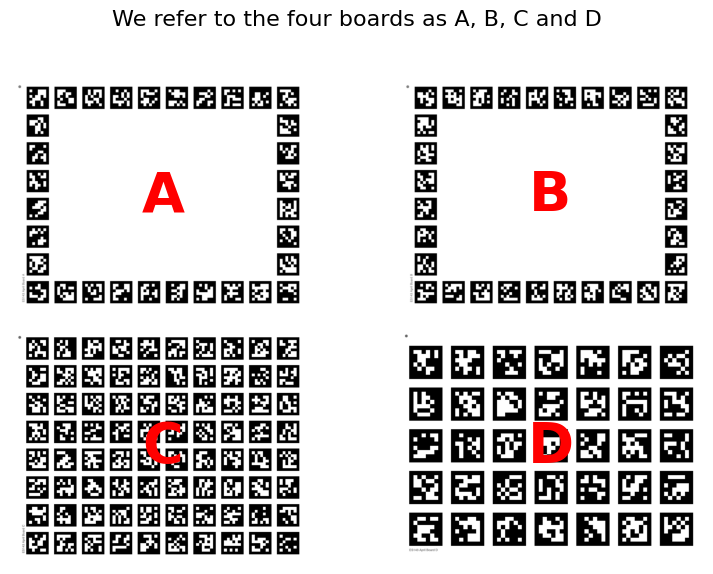

In [10]:
#@title Plot out the 4 AprilBoards for reference

# Load images
img_a = cv2.imread('AprilBoardA.png', cv2.IMREAD_GRAYSCALE)
img_b = cv2.imread('AprilBoardB.png', cv2.IMREAD_GRAYSCALE)
img_c = cv2.imread('AprilBoardC.png', cv2.IMREAD_GRAYSCALE)
img_d = cv2.imread('AprilBoardD.png', cv2.IMREAD_GRAYSCALE)

# Create 2x2 grid of subplots
fig, axes = plt.subplots(2, 2, figsize=(8, 6))
axes = axes.ravel()

# List of images and labels
boards = [(img_a, "A"), (img_b, "B"), (img_c, "C"), (img_d, "D")]

# Plot images with labels
for idx, (img, label) in enumerate(boards):
    ax = axes[idx]
    ax.imshow(img, cmap="gray")
    h, w = img.shape
    ax.text(w/2, h/2, label, color='red', fontsize=40, fontweight='bold', ha='center', va='center')
    ax.axis("off")

fig.suptitle("We refer to the four boards as A, B, C and D", fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


## Detect fiducials


In [11]:
def read_image_heic(fname):
    """
    Read HEIC image file. Falls back to OpenCV if not HEIC.

    Args:
        fname: Path to image file

    Returns:
        Image array (BGR format for OpenCV)
    """
    ext = os.path.splitext(fname)[1].lower()

    if ext == '.heic' or ext == '.heif':
        try:
            from PIL import Image
            import pillow_heif
            pillow_heif.register_heif_opener()

            img = Image.open(fname)
            # Convert PIL image to numpy array (RGB)
            img_array = np.array(img)
            # Convert RGB to BGR for OpenCV
            if len(img_array.shape) == 3:
                img_array = cv2.cvtColor(img_array, cv2.COLOR_RGB2BGR)
            return img_array
        except ImportError:
            raise ImportError("pillow-heif is required to read HEIC files. Install with: pip install pillow-heif")
        except Exception as e:
            raise ValueError(f"Error reading HEIC file {fname}: {e}")
    else:
        # Use OpenCV for other formats
        return cv2.imread(fname)

In [12]:
#@title Display one image from camera_calib_raw

# Get list of images in camera_calib_raw
calib_images = sorted(glob.glob('./camera_calib_raw/*.HEIC'))

# Select which image to display (change index to see different images)
image_index = 0

if calib_images:
    # Read the image
    img = read_image_heic(calib_images[image_index])

    # Convert to grayscale if needed
    if len(img.shape) == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Display the image
    plt.figure(figsize=(12, 8))
    plt.imshow(img, cmap='gray')
    plt.axis('off')
    plt.title(f'Image {image_index}: {calib_images[image_index].split("/")[-1]}', fontsize=14)
    plt.show()
else:
    print("No images found in camera_calib_raw folder")

No images found in camera_calib_raw folder


12 images:
0 ./camera_calib_raw2/IMG_0846.HEIC: 79 imgpts, 79 objpts
1 ./camera_calib_raw2/IMG_0847.HEIC: 80 imgpts, 80 objpts
2 ./camera_calib_raw2/IMG_0848.HEIC: 80 imgpts, 80 objpts
3 ./camera_calib_raw2/IMG_0849.HEIC: 80 imgpts, 80 objpts
4 ./camera_calib_raw2/IMG_0850.HEIC: 80 imgpts, 80 objpts
5 ./camera_calib_raw2/IMG_0851.HEIC: 80 imgpts, 80 objpts
6 ./camera_calib_raw2/IMG_0852.HEIC: 80 imgpts, 80 objpts
7 ./camera_calib_raw2/IMG_0853.HEIC: 80 imgpts, 80 objpts
8 ./camera_calib_raw2/IMG_0854.HEIC: 80 imgpts, 80 objpts
9 ./camera_calib_raw2/IMG_0855.HEIC: 80 imgpts, 80 objpts
10 ./camera_calib_raw2/IMG_0856.HEIC: 80 imgpts, 80 objpts
11 ./camera_calib_raw2/IMG_0857.HEIC: 80 imgpts, 80 objpts


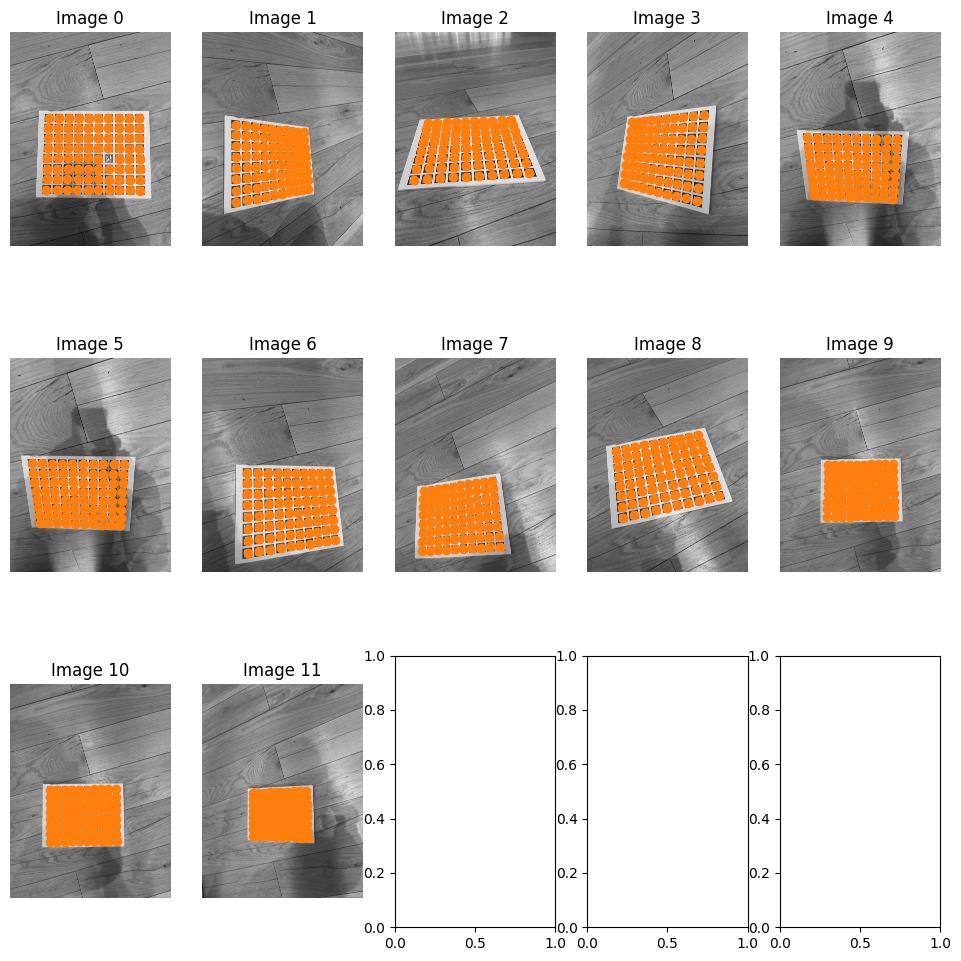

In [13]:
#@title Detect fiducials

N = 30  # only use images with at least N detected objects for calibration

total_valid = 0

# Get list of images in camera_calib_raw2 (same indexing as display cell)
calib_images = sorted(glob.glob('./camera_calib_raw2/*.HEIC'))

# Uncomment one of the following two lines to indicate which AprilBoard is being used for calibration
BOARD = at_board_c

###### BEGIN CALIBRATION SCRIPT

# set up april tag detector
at_detector = Detector(families='tag36h11',
                       nthreads=1,
                       quad_decimate=1.0,
                       quad_sigma=0.0,
                       refine_edges=1,
                       decode_sharpening=0.25,
                       debug=0)

# exit if no images are found or if BOARD is unrecognized
assert calib_images, "no calibration images found in camera_calib_raw2 folder"

# else continue
print("{} images:".format(len(calib_images)))

# initialize 3D object points and 2D image points
calObjPoints = []
calImgPoints = []
valid_image_files = []  # Track which images were actually used for calibration

# define the number of columns for the plot, then calculate number of rows
num_plot_cols = 5
num_plot_rows = (len(calib_images) + num_plot_cols - 1) // num_plot_cols

# create the figure and axes; flatten the axes array for convenience
fig, axs = plt.subplots(num_plot_rows, num_plot_cols, figsize=(12, 4*num_plot_rows))
axs = axs.flatten()

# loop through the images
for count, fname in enumerate(calib_images):
    # read image and convert to grayscale if necessary
    orig = read_image_heic(fname)
    if orig is None:
        print(f"Warning: Could not read {fname}, skipping...")
        continue

    if len(orig.shape) == 3:
        img = cv2.cvtColor(orig, cv2.COLOR_BGR2GRAY)
    else:
        img = orig

    # show image
    axs[count].imshow(img / 255.0, cmap="gray")
    axs[count].set_axis_off()
    axs[count].set_title("Image {}".format(count))

    # detect apriltags and report number of detections
    imgpoints, objpoints, tagIDs = detect_aprilboard(img, BOARD, at_detector)
    #print("{} {}: {} imgpts, {} objpts".format(count, fname, len(imgpoints),len(objpoints)))
    print(f"{count} {fname}: {len(imgpoints)} imgpts, {len(objpoints)} objpts")

    # append detections if some are found
    if len(imgpoints) >= N and len(objpoints) >= N:
        total_valid += 1
        # display detected tag centers
        axs[count].scatter(imgpoints[:,0], imgpoints[:,1], marker='o', color='#ff7f0e')
        # append points detected in all images, (there is only one image now)
        calObjPoints.append(objpoints.astype('float32'))
        calImgPoints.append(imgpoints.astype('float32'))
        valid_image_files.append(fname)  # Track which image was used

plt.show()


## Calibrate camera


In [14]:
#@title Calibrate camera

# calibrate the camera
reprojerr, calMatrix, distCoeffs, calRotations, calTranslations = cv2.calibrateCamera(
    calObjPoints,
    calImgPoints,
    img.shape,    # uses image H,W to initialize the principal point to (H/2,W/2)
    None,         # no initial guess for the remaining entries of calMatrix
    None,         # initial guesses for distortion coefficients are all 0
    flags = None) # default contstraints (see documentation)

# Print output, including reprojection error, which is the root mean square (RMS)
#   re-projection error in pixels. If this value is much greater than 1, it is
#   likely to be a bad calibration.  Examine the images and detections, and the
#   options given to cv2.calibrateCamera() to figure out what went wrong.
np.set_printoptions(precision=5, suppress=True)
print('RMSE of reprojected points:', reprojerr)
print('Distortion coefficients:', distCoeffs)

np.set_printoptions(precision=2, suppress=True)
print('Intrinsic camera matrix:\n', calMatrix)
print('Total images used for calibration: ', total_valid)

RMSE of reprojected points: 0.7589436645348389
Distortion coefficients: [[ 0.14447 -0.65312  0.00037 -0.00029  0.96316]]
Intrinsic camera matrix:
 [[3079.85    0.   1551.43]
 [   0.   3079.09 2027.83]
 [   0.      0.      1.  ]]
Total images used for calibration:  12


## Display the projected points in one of the images


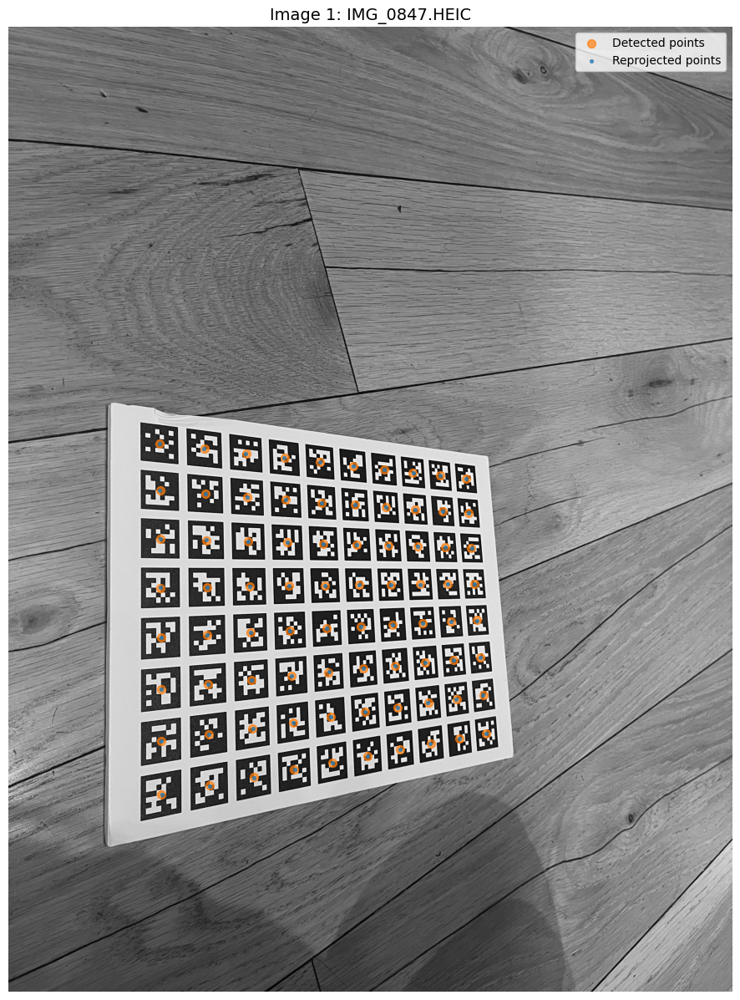

In [15]:
#@title Display the projected points in one of the images

# change this to select which calibration image to display
# IMNUM indexes into the valid images (only those used for calibration)
IMNUM = 1

# Make sure IMNUM is within valid range
assert 0 <= IMNUM < len(calImgPoints), f"IMNUM must be between 0 and {len(calImgPoints)-1}"

# Use valid_image_files to get the correct image file
# This ensures we're displaying the same image that was used for calibration at index IMNUM
image_file = valid_image_files[IMNUM]

# read image and convert to grayscale if necessary
orig = read_image_heic(image_file)
if orig is None:
    raise ValueError(f"Could not read image: {image_file}")

if len(orig.shape) == 3:
    img = cv2.cvtColor(orig, cv2.COLOR_BGR2GRAY)
else:
    img = orig

# create figure, show image
fig, ax = plt.subplots(figsize=(15, 15))
ax.imshow(img / 255.0, cmap="gray")
ax.set_axis_off()
ax.set_title(f"Image {IMNUM}: {image_file.split('/')[-1]}", fontsize=14)

# show detected points (in orange)
ax.scatter(calImgPoints[IMNUM][:,0], calImgPoints[IMNUM][:,1], marker='o', color='#ff7f0e', s=50, label='Detected points', alpha=0.7)

# compute reprojections
imgpoints2, _ = cv2.projectPoints(calObjPoints[IMNUM],
                                  calRotations[IMNUM],
                                  calTranslations[IMNUM],
                                  calMatrix, distCoeffs)
imgpoints2 = np.squeeze(imgpoints2)  # eliminate the leading single dimension

# show reprojected points (in blue)
ax.scatter(imgpoints2[:,0], imgpoints2[:,1], marker='.', color='#1f77b4', s=30, label='Reprojected points', alpha=0.7)
ax.legend()
plt.show()

# ============================================================================
# FUNCTION DEFINITIONS FOR STRUCTURE FROM MOTION
# ============================================================================
# All functions needed for the main SfM pipeline are defined below


# Detect and Match Points

## detect_matched_points function

In [16]:
def find_matches(keypoints1, keypoints2, descriptors1, descriptors2, percentage):
    """
    Find interest-point matches between two lists of interest point descriptors.

    Args
    ----
      keypoints1     : list of cv2.KeyPoint from Image 1
      keypoints2     : list of cv2.KeyPoint from Image 2
      descriptors1   : descriptor array from Image 1 (N1 x D)
      descriptors2   : descriptor array from Image 2 (N2 x D)
      percentage     : float in [0,1], fraction of best matches to keep

    Returns
    -------
      good_matches : list[cv2.DMatch]
          Sorted by increasing distance (best first).
          For each m in good_matches:
              keypoints1[m.queryIdx]  → point in Image 1
              keypoints2[m.trainIdx]  → point in Image 2
      X1 : (M x 2) numpy array of (x,y) points from Image 1 (only good matches)
      X2 : (M x 2) numpy array of (x,y) points from Image 2 (only good matches)
    """

    # If no descriptors, return empty
    if descriptors1 is None or descriptors2 is None:
        return [], np.zeros((0, 2), dtype=np.float32), np.zeros((0, 2), dtype=np.float32)

    # Brute force matcher with L2 norm and cross-check
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)

    # Match descriptors between images
    matches12 = bf.match(descriptors1, descriptors2)
    num_matches12 = len(matches12)

    if num_matches12 == 0:
        return [], np.zeros((0, 2), dtype=np.float32), np.zeros((0, 2), dtype=np.float32)

    # Sort matches by distance (smaller distance = better match)
    matches12 = sorted(matches12, key=lambda m: m.distance)

    # Clamp percentage to [0, 1]
    percentage = float(max(0.0, min(1.0, percentage)))
    num_good = max(1, int(percentage * num_matches12))

    # Keep the top 'percentage' of matches
    good_matches = matches12[:num_good]

    # Extract coordinates only for the good matches
    X1 = np.array([keypoints1[m.queryIdx].pt for m in good_matches], dtype=np.float32)
    X2 = np.array([keypoints2[m.trainIdx].pt for m in good_matches], dtype=np.float32)

    return good_matches, X1, X2


In [17]:
def detect_and_match_keypoints(img_grayscales, good_match_percentage=0.1):
    """
    Detect SIFT keypoints on all grayscale images and match keypoints between
    consecutive image pairs.

    Args
    ----
      img_grayscales       : list of grayscale images (numpy arrays)
      good_match_percentage: float in [0,1], fraction of best matches per pair

    Returns
    -------
      result : dict with keys
        - "keypoints_list"   : list where keypoints_list[i] is list of cv2.KeyPoint for image i
        - "descriptors_list" : list where descriptors_list[i] is descriptor array for image i
        - "pair_matches"     : dict keyed by (i, j) where j = i+1, e.g. (0,1), (1,2), ...
                               each entry is itself a dict:
                               {
                                 "matches" : list[cv2.DMatch],
                                 "points1" : (N x 2) array of points in image i,
                                 "points2" : (N x 2) array of points in image j
                               }
    """

    sift = cv2.SIFT_create()

    keypoints_list = []
    descriptors_list = []

    # Detect keypoints and descriptors for each image
    for img in img_grayscales:
        kps, desc = sift.detectAndCompute(img, None)
        keypoints_list.append(kps)
        descriptors_list.append(desc)

    # Match between consecutive image pairs
    pair_matches = {}
    num_images = len(img_grayscales)
    print(f"Processing {num_images} images")

    # Match all consecutive pairs
    for i in range(num_images - 1):
        kps1 = keypoints_list[i]
        kps2 = keypoints_list[i + 1]
        desc1 = descriptors_list[i]
        desc2 = descriptors_list[i + 1]

        matches, X1, X2 = find_matches(kps1, kps2, desc1, desc2, good_match_percentage)

        pair_matches[(i, i + 1)] = {
            "matches": matches,  # list of cv2.DMatch
            "points1": X1,       # Nx2 coords in image i
            "points2": X2        # Nx2 coords in image i+1
        }
        print(f"finished img {i}")

    result = {
        "keypoints_list": keypoints_list,
        "descriptors_list": descriptors_list,
        "pair_matches": pair_matches
    }
    return result


In [18]:
# Get all image paths from scene_raw2
scene_images = sorted(glob.glob('./scene_raw_2/*.HEIC'))

# Read all images, keep both color (for visualization) and grayscale (for SIFT)
color_images = []
img_grayscales = []

for path in scene_images:
    img_color = read_image_heic(path)
    color_images.append(img_color)

    if len(img_color.shape) == 2:
        img_gray = cv2.cvtColor(img_color, cv2.COLOR_BGR2GRAY)
    else:
        img_gray = img_color

    img_grayscales.append(img_gray)

num_images = len(img_grayscales)

# Run detect+match function on all grayscale images
# Keep only top 10% of matches for highest quality (sorted by distance, best first)
data = detect_and_match_keypoints(img_grayscales, good_match_percentage=0.10)

keypoints_list   = data["keypoints_list"]
descriptors_list = data["descriptors_list"]
pair_matches     = data["pair_matches"]


Processing 10 images
finished img 0
finished img 1
finished img 2
finished img 3
finished img 4
finished img 5
finished img 6
finished img 7
finished img 8


## matches_visualzation

In [19]:
def show_matches_for_pair(pair_index):
    """
    Visualize matches between image pair (pair_index, pair_index+1).
    """
    i = pair_index
    j = pair_index + 1

    # Grab images (color for display)
    im1 = color_images[i]
    im2 = color_images[j]

    # Grab keypoints
    kp1 = keypoints_list[i]
    kp2 = keypoints_list[j]

    # Grab matches for this pair
    matches = pair_matches[(i, j)]["matches"]

    print(f"Pair ({i}, {j}) has {len(matches)} good matches")

    # Draw matches
    im_matches = cv2.drawMatches(
        im1, kp1,
        im2, kp2,
        matches,
        None,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
    )

    # Convert BGR -> RGB for matplotlib
    im_matches_rgb = cv2.cvtColor(im_matches, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(20, 12))
    plt.imshow(im_matches_rgb)
    plt.axis('off')
    plt.title(f"Matches between Image {i} and Image {j}")
    plt.show()


VISUALIZATION: Image Matches Between Consecutive Pairs
Pair (0, 1) has 296 good matches


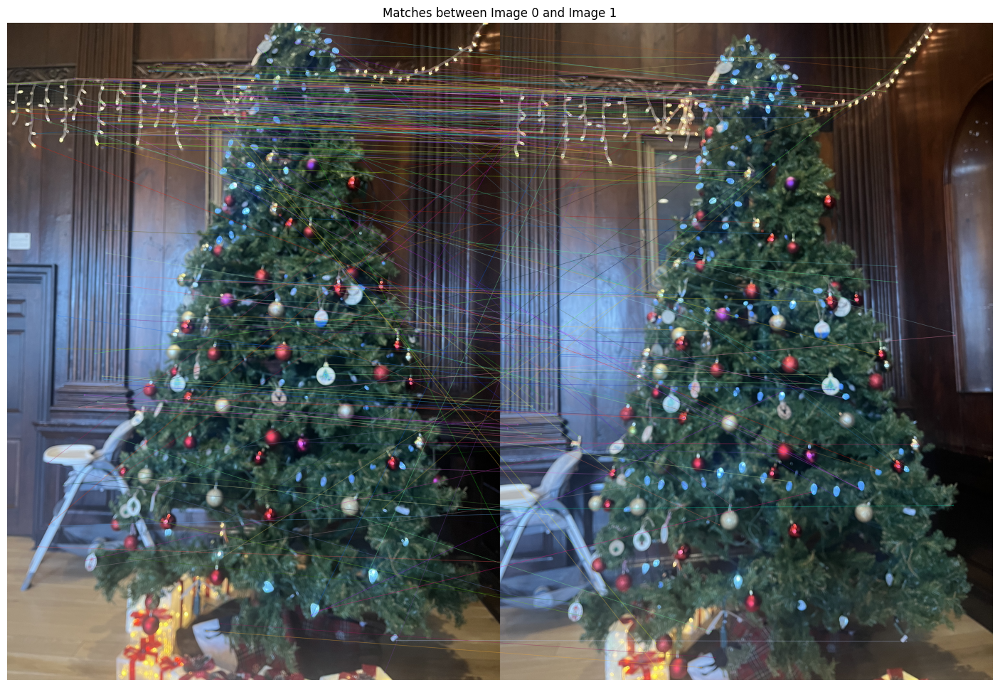

Pair (1, 2) has 520 good matches


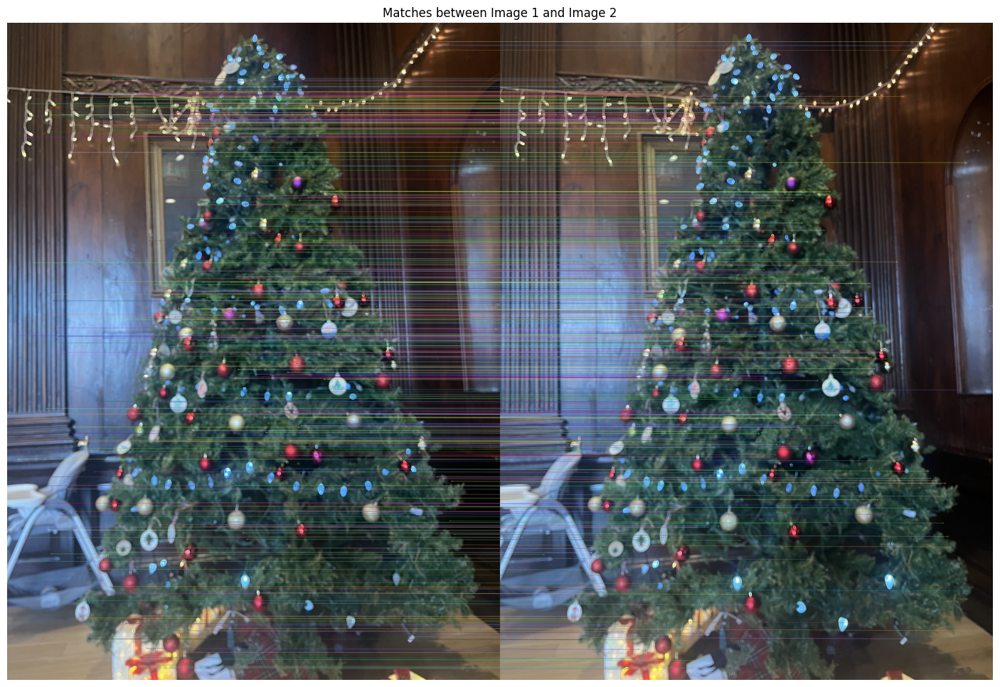

Pair (2, 3) has 287 good matches


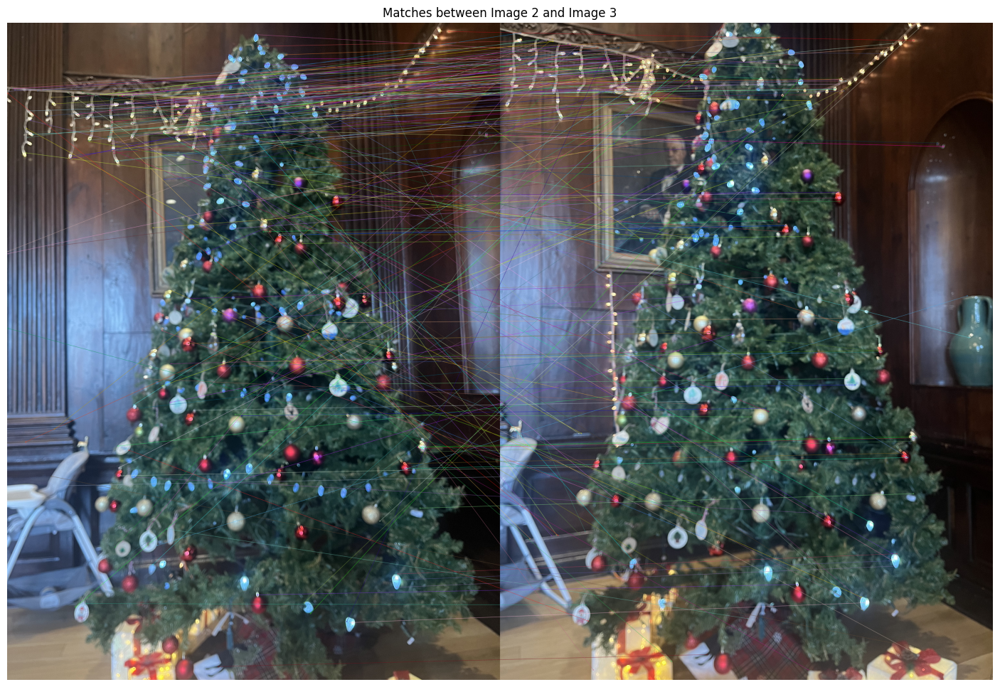

Pair (3, 4) has 326 good matches


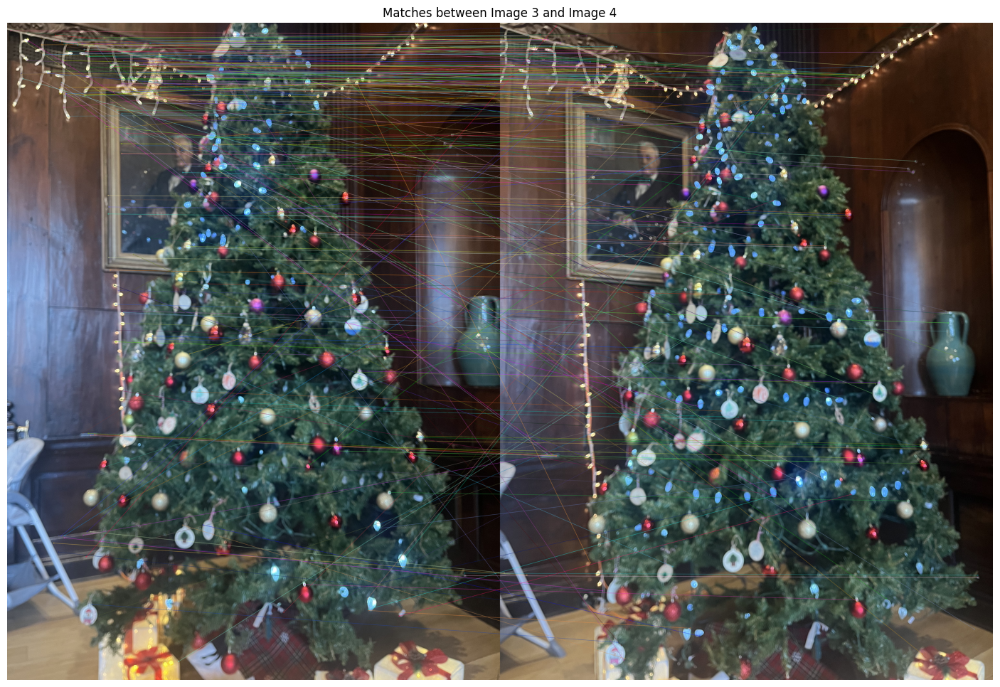

Pair (4, 5) has 326 good matches


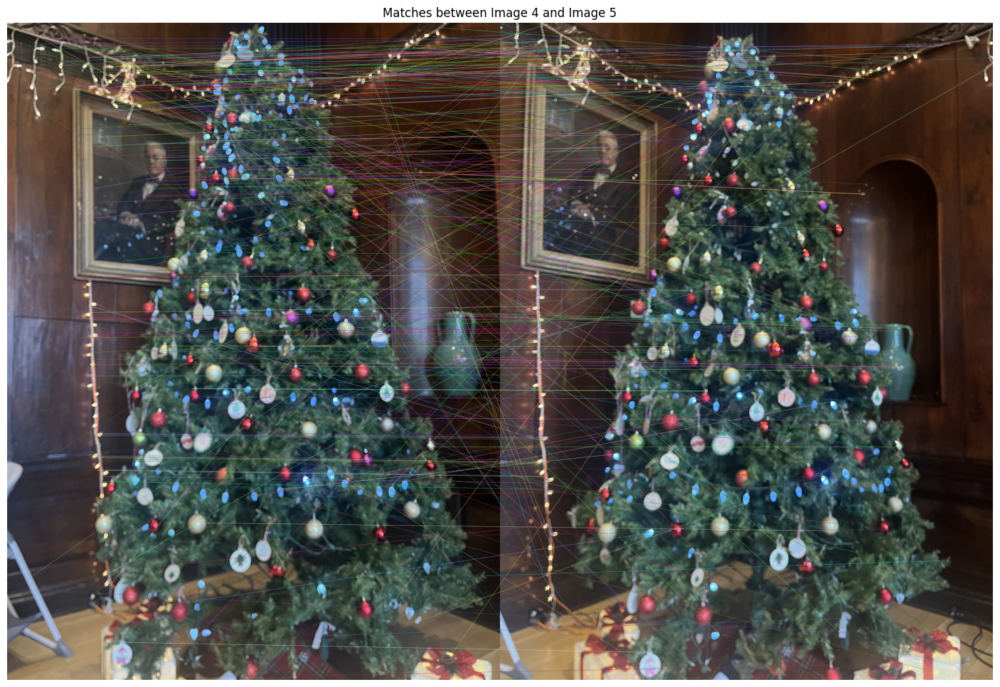

Pair (5, 6) has 352 good matches


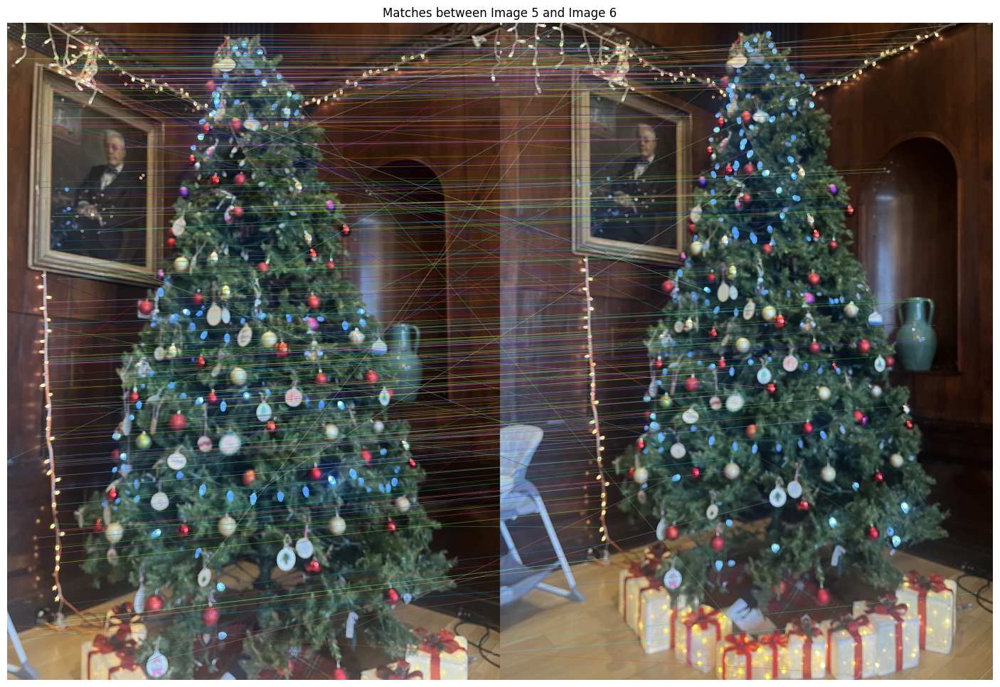

Pair (6, 7) has 274 good matches


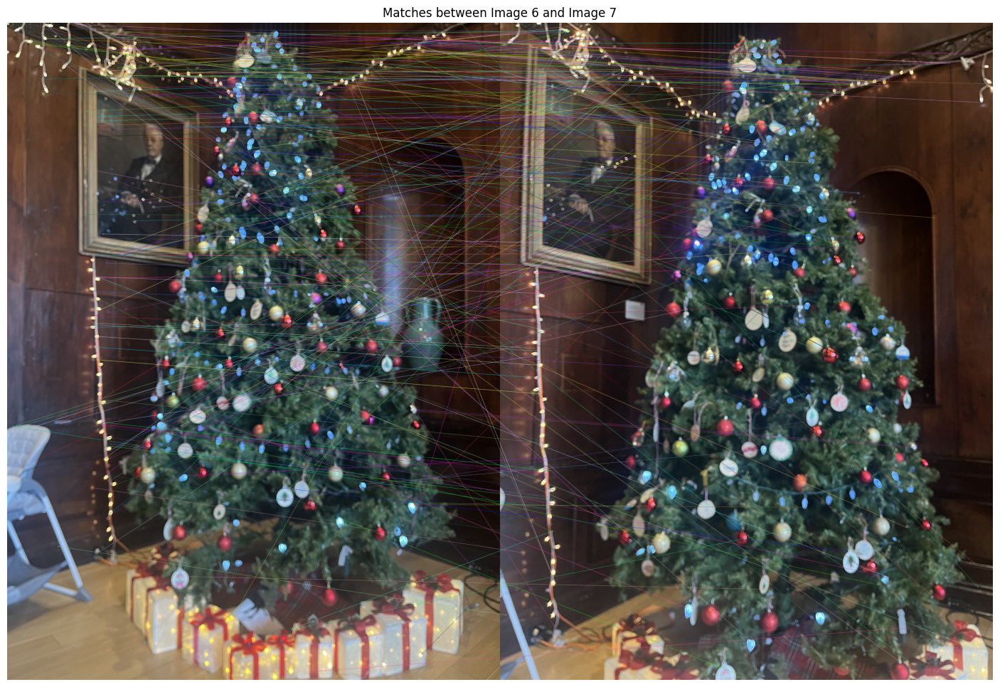

Pair (7, 8) has 496 good matches


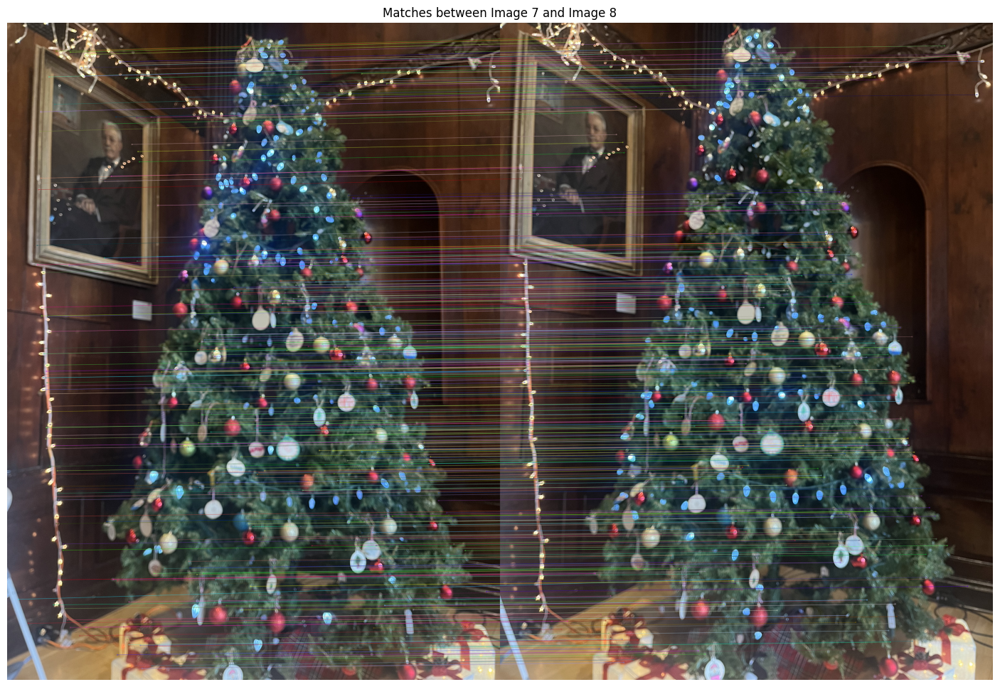

Pair (8, 9) has 344 good matches


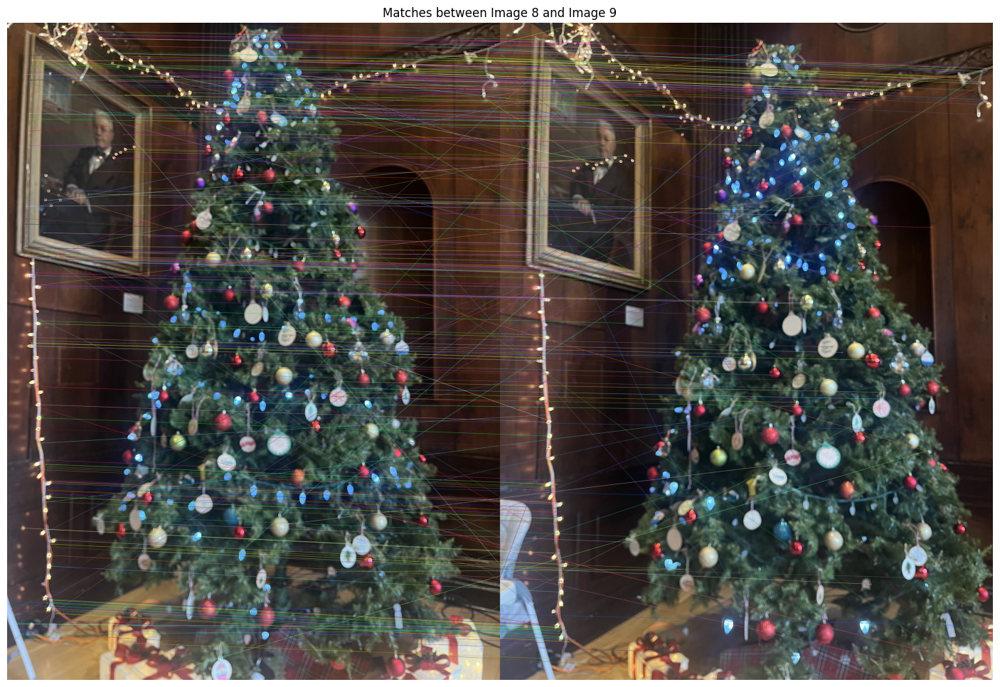

In [20]:
# Visualize matches for all consecutive image pairs
print("=" * 70)
print("VISUALIZATION: Image Matches Between Consecutive Pairs")
print("=" * 70)
for pair_idx in range(num_images - 1):
    if (pair_idx, pair_idx + 1) in pair_matches:
        show_matches_for_pair(pair_idx)   # matches between image i and i+1
    else:
        print(f"Pair ({pair_idx}, {pair_idx + 1}) not found in pair_matches")


# Essential Matrix

In [21]:
def estimate_essential_and_pose_first_pair(pair_matches, camera_matrix, pair_key=(0, 1)):
    """
    Estimate the essential matrix and relative pose (R, t) between
    the first two cameras (by default pair (0,1)) using RANSAC.

    Args
    ----
      pair_matches : dict
          From detect_and_match_keypoints()['pair_matches'].
          Must contain pair_matches[(0,1)] with:
              {
                "matches": list[cv2.DMatch],
                "points1": (N x 2) array of points in image 0,
                "points2": (N x 2) array of points in image 1
              }

      camera_matrix : (3 x 3) numpy array
          Intrinsic matrix K.

      pair_key : tuple (i, j)
          Which pair to use (default (0,1)).

    Returns
    -------
      E : (3 x 3) essential matrix
      R : (3 x 3) rotation from camera i to camera j
      t : (3 x 1) translation (up to scale) from camera i to camera j
      mask : (N x 1) uint8 inlier mask from RANSAC
    """
    i, j = pair_key
    if pair_key not in pair_matches:
        raise ValueError(f"pair_matches does not contain key {pair_key}")

    entry = pair_matches[pair_key]
    points1 = entry["points1"]  # Nx2 in image i
    points2 = entry["points2"]  # Nx2 in image j

    if points1.shape[0] < 5:
        raise ValueError(f"Not enough matches ({points1.shape[0]}) to estimate essential matrix.")

    # Estimate essential matrix with RANSAC
    E, mask = cv2.findEssentialMat(
        points1,
        points2,
        camera_matrix,
        method=cv2.RANSAC,
        prob=0.999,
        threshold=1.0
    )

    if E is None:
        raise RuntimeError("findEssentialMat failed to compute a valid essential matrix.")

    # Recover relative pose between the two cameras
    #    (camera i is reference; result is pose of camera j)
    _, R, t, mask_pose = cv2.recoverPose(E, points1, points2, camera_matrix, mask=mask)

    # mask_pose may refine the inliers; you can use it instead of mask if you want
    inlier_ratio = float(mask_pose.sum()) / float(mask_pose.size)
    print(f"Pair ({i},{j}): recovered pose, inlier ratio = {inlier_ratio:.2f}")

    return E, R, t, mask_pose


In [22]:
E_01, R_01, t_01, mask_01 = estimate_essential_and_pose_first_pair(pair_matches, calMatrix)

print("Essential matrix E_01:\n", E_01)
print("Rotation R_01:\n", R_01)
print("Translation t_01:\n", t_01)
print("Mask shape:", mask_01.shape)
print("Inliers:", int(mask_01.sum()), "/", mask_01.size)


Pair (0,1): recovered pose, inlier ratio = 0.26
Essential matrix E_01:
 [[-0.01 -0.04 -0.06]
 [-0.11  0.03 -0.69]
 [ 0.04  0.7   0.02]]
Rotation R_01:
 [[ 0.98  0.05 -0.22]
 [-0.04  1.    0.05]
 [ 0.22 -0.04  0.98]]
Translation t_01:
 [[ 0.99]
 [-0.09]
 [ 0.06]]
Mask shape: (296, 1)
Inliers: 76 / 296


# Triangulation

In [23]:
# Global / module-level
camera_poses = []   # camera_poses[cam_idx] = (R, t)
K = calMatrix       # your intrinsics

def add_camera_pose(R, t):
    """
    Add a camera pose (R, t) and return its index.
    """
    camera_poses.append((R, t))
    return len(camera_poses) - 1

def get_projection_pair(pair_key, K, camera_poses):
    """
    Given a pair_key = (i, j), return (P_i, P_j)
    where P_k = K [R_k | t_k].
    """
    i, j = pair_key

    R_i, t_i = camera_poses[i]
    R_j, t_j = camera_poses[j]

    P_i = K @ np.hstack([R_i, t_i])
    P_j = K @ np.hstack([R_j, t_j])

    return P_i, P_j

# Camera 0 at origin
R0 = np.eye(3, dtype=float)
t0 = np.zeros((3, 1), dtype=float)

cam0_idx = add_camera_pose(R0, t0)
print("Added camera 0 → index:", cam0_idx)
cam1_idx = add_camera_pose(R_01, t_01)
print("Added camera 1 → index:", cam1_idx)


P0, P1 = get_projection_pair((0, 1), K, camera_poses)
print("P0:\n", P0)
print("P1:\n", P1)

camera_matrices = [P0, P1]


Added camera 0 → index: 0
Added camera 1 → index: 1
P0:
 [[3079.85    0.   1551.43    0.  ]
 [   0.   3079.09 2027.83    0.  ]
 [   0.      0.      1.      0.  ]]
P1:
 [[3340.79   85.57  851.   3151.59]
 [ 322.86 2993.04 2128.46 -159.65]
 [   0.22   -0.04    0.98    0.06]]


In [24]:
# added 12.12
def initialize_corr(num_images):
  corr = {
    "scene_points_3d": [],        # list of 3D points (N x 3)
    "matches_2d_location": [],    # list of 2D coordinates
    "scene_point_features": [],   # list of descriptors
    "num_images": num_images
  }

  return corr


In [25]:
# # added 12.12
# def find_existing_point(corr, cam_idx, kp_idx):
#   # Check if a point already exists in the scene based on camera and keypoint index.
#   for point_idx, scene_point_feature in enumerate(corr["scene_point_features"]):
#     if len(scene_point_feature) > cam_idx and scene_point_feature[cam_idx] == kp_idx:
#       return point_idx
#   return None

def find_existing_point(corr, cam_idx, kp_idx):
  # Check if a point already exists in the scene based on camera and keypoint index.
  for point_idx, scene_point_feature in enumerate(corr["scene_point_features"]):

    if scene_point_feature is None:
      continue

    if cam_idx < len(scene_point_feature) and scene_point_feature[cam_idx] == kp_idx:
      return point_idx
  return None



In [26]:
# added 12.12
def update_existing_point(corr, point_idx, cam_idx, kp_idx, x, y):
  # Update an existing 3D point with a new observation from a new camera.

  # first, make sure that lists are long enough for new camera
  while len(corr['matches_2d_location'][point_idx]) < cam_idx + 1:
    corr['matches_2d_location'][point_idx].append(None)
  while len(corr['scene_point_features'][point_idx]) < cam_idx + 1:
    corr['scene_point_features'][point_idx].append(None)

  # Update the observation
  corr['matches_2d_location'][point_idx][cam_idx] = (float(x), float(y))
  corr['scene_point_features'][point_idx][cam_idx] = int(kp_idx)


In [27]:
# added 12.12
def add_new_point(corr, point_3d, observations):
  ''' args:
  - corr : corrwspondence structure
  - point_3d : 3D point
  - observations: list of tuples (cam_idx, kp_idx, x, y) representing which cameras see this point

  '''

  # Add a new 3D point to the scene
  num_images = corr['num_images']
  point_idx = len(corr['scene_points_3d'])

  corr['scene_points_3d'].append(point_3d.copy())

  # initialize observation lists
  matches_2d = [None] * num_images
  scene_features = [None] * num_images

  # add in observations
  for cam_idx, kp_idx, x, y in observations:
    matches_2d[cam_idx] = (float(x), float(y))
    scene_features[cam_idx] = int(kp_idx)

  corr['matches_2d_location'].append(matches_2d)
  corr['scene_point_features'].append(scene_features)

  return point_idx

In [28]:
# added 12.12

def triangulate_pair(pair_key, pair_matches, camera_matrices, corr):
    """
    Triangulate 3D scene points from one matched image pair.

    Args
    ----
      pair_key : tuple (i, j)
          Example: (0, 1)

      pair_matches : dict
          pair_matches[(i, j)] must contain:
              {
                "matches": list[cv2.DMatch],
                "points1": (N x 2) array of 2D points in image i,
                "points2": (N x 2) array of 2D points in image j
              }

      camera_matrices : list of 3x4 matrices
          camera_matrices[k] = P_k for the k-th image

    Returns
    -------
      result : number of updated points and number of new points;
              to get info (dict) of scene points, call corr structure
    """


    i, j = pair_key
    entry = pair_matches[pair_key]

    matches = entry["matches"]
    pts1 = entry["points1"]  # Nx2
    pts2 = entry["points2"]  # Nx2

    if pts1.shape[0] == 0:
        return 0, 0

    P_i = camera_matrices[i]
    P_j = camera_matrices[j]

    num_updated = 0
    num_new = 0

    # Convert (N x 2) → (2 x N)
    pts1_2xN = pts1.T
    pts2_2xN = pts2.T

    # Triangulate
    # points_4d = cv2.triangulatePoints(P_i, P_j, pts1_2xN, pts2_2xN)
    # points_3d = (points_4d[:3] / points_4d[3]).T  # (N x 3)

    # num_images = len(camera_matrices)
    # matches_2d_location = []
    # features = []

    for k, m in enumerate(matches):
        # Lists for each image - removed, prev initialized in add_new_point
        # loc_k  = [None] * num_images
        # feat_k = [None] * num_images

        # Fill in image i
        kp_idx_i = m.queryIdx
        x1, y1 = pts1[k]

        # Fill in image j
        kp_idx_j = m.trainIdx
        x2, y2 = pts2[k]

        # check if points already prev exist
        existing_i = find_existing_point(corr, i, kp_idx_i)
        existing_j = find_existing_point(corr, j, kp_idx_j)

        if existing_i is not None and existing_j is not None:
          # if they exist (in both cameras), skip
          continue
        elif existing_i is not None:
          # if only one exists (in camera i), update with observation from camera j
          update_existing_point(corr, existing_i, j, kp_idx_j, x2, y2)
          num_updated += 1
        else:
          # new point, triangulate
          pts1_col = np.array([[x1], [y1]], dtype=np.float32)
          pts2_col = np.array([[x2], [y2]], dtype=np.float32)

          point_4d = cv2.triangulatePoints(P_i, P_j, pts1_col, pts2_col)
          point_3d = (point_4d[:3] / point_4d[3]).flatten()

          # add them to the corr structure
          observations = [
                (i, kp_idx_i, x1, y1),
                (j, kp_idx_j, x2, y2)]
          add_new_point(corr, point_3d, observations)
          num_new += 1

    return num_updated, num_new


In [29]:
corr = initialize_corr(num_images)

# Triangulate (0,1)
num_updated_01, num_new_01 = triangulate_pair(
    (0, 1),
    pair_matches,
    camera_matrices,
    corr
)

print(f"Pair (0, 1): updated {num_updated_01} points, created {num_new_01} new points")

# Inspect what's stored in corr
scene_points_3d      = corr["scene_points_3d"]
matches_2d_locations = corr["matches_2d_location"]
features_per_point   = corr["scene_point_features"]

print("Total triangulated 3D points:", len(scene_points_3d))

if len(scene_points_3d) > 0:
    print("First 3D point:", scene_points_3d[0])
    print("2D matches for this point:", matches_2d_locations[0])
    print("Keypoint IDs:", features_per_point[0])

    # nicer formatting
    print("\nReadable observations for point 0:")
    for cam_idx, (obs, kp_id) in enumerate(zip(matches_2d_locations[0], features_per_point[0])):
        if obs is None:
            continue
        x, y = obs
        print(f"  Camera {cam_idx}: (x={x:.2f}, y={y:.2f}), kp_idx={kp_id}")


Pair (0, 1): updated 0 points, created 296 new points
Total triangulated 3D points: 296
First 3D point: [-1.12 -4.03  8.67]
2D matches for this point: [(1154.1019287109375, 596.9351196289062), (764.8924560546875, 695.5311889648438), None, None, None, None, None, None, None, None]
Keypoint IDs: [2897, 1481, None, None, None, None, None, None, None, None]

Readable observations for point 0:
  Camera 0: (x=1154.10, y=596.94), kp_idx=2897
  Camera 1: (x=764.89, y=695.53), kp_idx=1481


# Visualize Scene Points

visualize_scene_points(scene_points, camera_poses)

Purpose:

Input:
3d world points (scene_points)

Poses (R,t) for all of the cameras (camera_poses)

Output:

Nothing returned

Plot a 3d plot of the image points and the camera positions for all of the cameras

Unit test(s) and/or other plans to verify and demonstrate correctness:
Look at it and see if it looks right

Points should form a recognizable structure that looks like what we recorded in the video/set of images


In [30]:
def visualize_scene_points(scene_points, camera_poses, img_h, img_w):
  # Add points to figure as a scatterplot
  # Clean points slightly
  valid = np.all(np.isfinite(scene_points), axis=2)

  if not np.any(valid):
      print("no valid points to plot.")
      return go.Figure()

  # extract X, Y, Z values for each point
  X = scene_points[:, :, 0][valid]
  Y = scene_points[:, :, 1][valid]
  Z = scene_points[:, :, 2][valid]

  # Plot points and make figure
  fig = go.Figure(
        data=[
            go.Scatter3d(
                x=X, y=Y, z=Z,
                mode='markers',
                marker=dict(size=2,
                            opacity = 0.8)
            )
        ]
    )

  # Add cameras
  for i, (R, t) in enumerate(camera_poses):
      # compute camera matrix from rotation and translation
      P = np.hstack((R, t))
      add_plotly_camera(img_h, img_w, P, 2, fig)

  fig.update_layout(
      scene=dict(
          aspectmode='data',
          xaxis=dict(title='x'),
          yaxis=dict(title='y'),
          zaxis=dict(title='z')
      ),
      margin=dict(l=0, r=0, t=30, b=0),
      title='3D Scene Points and Camera Poses',
      scene_camera=dict(
          up=dict(x=0, y=-1, z=0),
          center=dict(x=0, y=0, z=0),
          eye=dict(x=0, y=0, z=-2)
      )
  )

  return fig




In [31]:
# Get scene points from corr and convert to proper shape
points_list = corr["scene_points_3d"]          # list of length N, each (3,)
if len(points_list) == 0:
    print("No 3D points to visualize.")
else:
    scene_points = np.array(points_list, dtype=float)      # (N, 3)
    scene_points = scene_points[None, :, :]                # -> (1, N, 3)

# Camera 0 at world origin
R0 = np.eye(3)
t0 = np.zeros((3, 1))

# Camera 1 from recoverPose
# (your R_01 and t_01 already come from cv2.recoverPose)
camera_poses = [
    (R0, t0),
    (R_01, t_01)
]

# Set image size (use your actual values)
img_h, img_w = img_grayscales[0].shape[:2]

# Visualize
fig = visualize_scene_points(scene_points, camera_poses, img_h, img_w)
# Use browser renderer to avoid nbformat requirement, or try default
try:
    fig.show(renderer='browser')  # Opens in browser
except Exception as e:
    try:
        fig.show()  # Try default renderer
    except Exception as e2:
        # If both fail, try IPython display
        try:
            from IPython.display import display
            display(fig)
        except:
            print(f"Visualization error: {e2}")
            print("To fix: Install nbformat with: pip install nbformat>=4.2.0")
            print("Or the figure object is available as 'fig' variable")


In [32]:
# scene_points has shape (1, N, 3)
pts = scene_points[0]                 # (N, 3)

# Compute Euclidean distance from origin
dist = np.linalg.norm(pts, axis=1)

# Choose a cutoff — e.g., remove anything further than 3× median distance
threshold = 3 * np.median(dist)

mask = dist < threshold
clean_pts = pts[mask]

print(f"Filtered from {len(pts)} → {len(clean_pts)} points")

# reshape back to (1, N_clean, 3)
scene_points_clean = clean_pts[None, :, :]
fig = visualize_scene_points(scene_points_clean, camera_poses, img_h, img_w)
# Use browser renderer to avoid nbformat requirement, or try default
try:
    fig.show(renderer='browser')  # Opens in browser
except Exception as e:
    try:
        fig.show()  # Try default renderer
    except Exception as e2:
        # If both fail, try IPython display
        try:
            from IPython.display import display
            display(fig)
        except:
            print(f"Visualization error: {e2}")
            print("To fix: Install nbformat with: pip install nbformat>=4.2.0")
            print("Or the figure object is available as 'fig' variable")



Filtered from 296 → 290 points


In [33]:
pts = scene_points[0]   # (N, 3)

def depth_in_cam(R, t, pts):
    # X_cam = R X + t
    X_cam = (R @ pts.T + t).T   # (N, 3)
    return X_cam[:, 2]          # z coordinate

z0 = depth_in_cam(R0, t0, pts)
z1 = depth_in_cam(R_01, t_01, pts)

print("Fraction in front of cam 0:", np.mean(z0 > 0))
print("Fraction in front of cam 1:", np.mean(z1 > 0))


Fraction in front of cam 0: 0.9290540540540541
Fraction in front of cam 1: 0.9290540540540541


# estimate_new_camera_pose

In [34]:
def estimate_new_camera_pose(
    new_img_gray,
    K,
    scene_points_3d,
    scene_point_features,
    descriptors_list,
    good_match_ratio=0.75,
    min_inliers=20
):
    """
    Estimate pose (R, t) of a new camera given an existing 3D map.
    """

    num_cams_so_far = len(descriptors_list)
    num_points = scene_points_3d.shape[0]

    # Detect SIFT in new image
    sift = cv2.SIFT_create()
    kp_new, desc_new = sift.detectAndCompute(new_img_gray, None)

    if desc_new is None or len(kp_new) < 4:
        raise RuntimeError("Not enough keypoints/descriptors in new image for PnP.")

    # Build descriptor list for 3D points: use last valid observation
    point_descriptors = []
    point_indices = []  # index into scene_points_3d

    for p_idx in range(num_points):
        feats = scene_point_features[p_idx]  # this may be shorter than num_cams_so_far

        # only iterate over the cameras that actually exist in this feature list
        for cam_idx in range(len(feats) - 1, -1, -1):
            kp_idx = feats[cam_idx]
            if kp_idx is not None:
                # safe: cam_idx < num_cams_so_far because feats was built earlier
                desc_cam = descriptors_list[cam_idx]
                point_descriptors.append(desc_cam[kp_idx])
                point_indices.append(p_idx)
                break  # stop at the last valid observation

    if len(point_descriptors) == 0:
        raise RuntimeError("No 3D points have valid descriptors to match against.")

    point_descriptors = np.asarray(point_descriptors, dtype=np.float32)

    # Match 3D-point descriptors to new image descriptors
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
    matches_knn = bf.knnMatch(point_descriptors, desc_new, k=2)

    good_obj_points = []
    good_img_points = []
    good_scene_indices = []
    good_kp_indices = []
    used_scene_indices = set()

    for m, n in matches_knn:
        if m.distance < good_match_ratio * n.distance:
            scene_idx = point_indices[m.queryIdx]
            if scene_idx in used_scene_indices:
                continue  # avoid duplicates
            used_scene_indices.add(scene_idx)

            X = scene_points_3d[scene_idx]
            u, v = kp_new[m.trainIdx].pt

            good_obj_points.append(X)
            good_img_points.append((u, v))
            good_scene_indices.append(scene_idx)
            good_kp_indices.append(m.trainIdx)

    if len(good_obj_points) < 4:
        raise RuntimeError(f"Not enough 2D–3D matches for PnP: {len(good_obj_points)} found.")

    obj_pts = np.asarray(good_obj_points, dtype=np.float32).reshape(-1, 1, 3)
    img_pts = np.asarray(good_img_points, dtype=np.float32).reshape(-1, 1, 2)

    # Solve PnP with RANSAC
    success, rvec, tvec, inliers = cv2.solvePnPRansac(
        obj_pts,
        img_pts,
        K,
        None,
        flags=cv2.SOLVEPNP_ITERATIVE
    )

    if not success or inliers is None or len(inliers) < min_inliers:
        raise RuntimeError(f"PnP failed or too few inliers: {0 if inliers is None else len(inliers)}")

    R_new, _ = cv2.Rodrigues(rvec)
    t_new = tvec  # (3 x 1)



    inlier_mask = np.zeros((len(good_obj_points), 1), dtype=np.uint8)
    inlier_mask[inliers[:, 0]] = 1

    correspondences = {
        "object_points_3d": np.asarray(good_obj_points, dtype=np.float32),
        "image_points_2d": np.asarray(good_img_points, dtype=np.float32),
        "scene_indices": good_scene_indices,
        "keypoint_indices": good_kp_indices
    }

    # Note: camera_poses is updated inside this function
    # The caller should handle adding to camera_poses list

    return R_new, t_new, inlier_mask, kp_new, desc_new, correspondences


In [35]:
# Convert scene points to numpy array
scene_points_3d_np = np.asarray(corr["scene_points_3d"], dtype=np.float32)

scene_point_features = corr["scene_point_features"]
new_img_gray = img_grayscales[2]   # camera index 2

R_2, t_2, inlier_mask_2, kp_2, desc_2, correspondences_2 = estimate_new_camera_pose(
    new_img_gray,
    calMatrix,
    scene_points_3d_np,
    scene_point_features,
    descriptors_list,      # descriptors for cams 0 and 1
    good_match_ratio=0.75,
    min_inliers=20
)

print("New camera 2 pose:")
print("R_2 =\n", R_2)
print("t_2 =\n", t_2)
print("Num inliers:", int(inlier_mask_2.sum()))

descriptors_list.append(desc_2)   # descriptors_list[2] now corresponds to cam 2

print(camera_poses)


New camera 2 pose:
R_2 =
 [[ 0.98  0.05 -0.21]
 [-0.04  1.    0.05]
 [ 0.22 -0.04  0.98]]
t_2 =
 [[ 0.99]
 [-0.08]
 [ 0.04]]
Num inliers: 113
[(array([[1., 0., 0.],
       [0., 1., 0.],
       [0., 0., 1.]]), array([[0.],
       [0.],
       [0.]])), (array([[ 0.98,  0.05, -0.22],
       [-0.04,  1.  ,  0.05],
       [ 0.22, -0.04,  0.98]]), array([[ 0.99],
       [-0.09],
       [ 0.06]]))]


## estimate_new_camera Visualization

In [36]:
# Update camera_poses with the new camera
# existing cameras
R0 = np.eye(3)
t0 = np.zeros((3, 1))

camera_poses = [
    (R0,   t0),    # cam 0
    (R_01, t_01),  # cam 1
    (R_2,  t_2),   # cam 2 (new)
]

# Helper to filter outliers and visualize
def depth_in_cam(R, t, pts_world):
    """
    pts_world: (N, 3)
    returns z-depth in that camera: (N,)
    X_cam = R * X_world + t
    """
    X_cam = (R @ pts_world.T + t).T   # (N, 3)
    return X_cam[:, 2]

def visualize_scene_points_clean(corr, camera_poses, img_grayscales):
    # Get raw 3D points
    points_list = corr["scene_points_3d"]
    if len(points_list) == 0:
        print("No 3D points to visualize.")
        return

    pts = np.asarray(points_list, dtype=float)   # (N, 3)

    # Remove NaNs / infs
    finite_mask = np.isfinite(pts).all(axis=1)
    pts = pts[finite_mask]
    if pts.shape[0] == 0:
        print("All points are non-finite.")
        return

    # Cheirality: keep only points in front of ALL cameras
    mask_all = np.ones(pts.shape[0], dtype=bool)
    for (R, t) in camera_poses:
        z = depth_in_cam(R, t, pts)
        mask_all &= (z > 0)

    pts = pts[mask_all]
    if pts.shape[0] == 0:
        print("No points in front of all cameras.")
        return

    # Distance-based trimming for far-out outliers
    dist = np.linalg.norm(pts, axis=1)
    median_dist = np.median(dist)
    thresh = 3.0 * median_dist       # you can tune this
    pts = pts[dist < thresh]

    print(f"Visualizing {pts.shape[0]} cleaned points.")

    # Shape to (1, N, 3) for your visualize_scene_points function
    scene_points_clean = pts[None, :, :]

    # Image size from any image
    img_h, img_w = img_grayscales[0].shape[:2]

    # Call your existing visualizer
    fig = visualize_scene_points(scene_points_clean, camera_poses, img_h, img_w)
    fig.show()
    return fig

# Call it
fig = visualize_scene_points_clean(corr, camera_poses, img_grayscales)


Visualizing 272 cleaned points.


In [37]:
## Update scene point
camera_matrices = [K @ np.hstack([R, t]) for (R, t) in camera_poses]

# Triangulate (1,2)
num_updated_12, num_new_12 = triangulate_pair(
    (1, 2),
    pair_matches,
    camera_matrices,
    corr
)

# ============================================================================
# BUNDLE ADJUSTMENT SECTION (SKIPPED IN MAIN PIPELINE)
# ============================================================================
# The bundle adjustment functions and code are kept here for reference,
# but are NOT executed in the main pipeline loop above.
# Uncomment the cells below if you want to run bundle adjustment.


In [38]:
# Visualise added scene points
fig = visualize_scene_points_clean(corr, camera_poses, img_grayscales)

Visualizing 745 cleaned points.


# Build Bundle Dictionary

In [39]:
def build_bundle_adjustment_data(corr):
    """
    Build per-camera BA dictionaries from correspondence structure.

    Returns
    -------
    scene_point_bundle : dict[cam_idx] = list of (scene_idx, 3D point)
    image_point_bundle : dict[cam_idx] = list of (u, v)
    """

    num_cams = corr["num_images"]
    num_points = len(corr["scene_points_3d"])

    scene_points_3d = corr["scene_points_3d"]
    matches_2d = corr["matches_2d_location"]

    # Initialize empty lists for each camera
    scene_point_bundle = {cam_idx: [] for cam_idx in range(num_cams)}
    image_point_bundle = {cam_idx: [] for cam_idx in range(num_cams)}

    # Loop over all scene points
    for p_idx in range(num_points):

        for cam_idx in range(num_cams):
            obs = matches_2d[p_idx][cam_idx]

            if obs is None:
                continue   # camera did NOT observe this 3D point

            # Extract data
            X_3d = scene_points_3d[p_idx]         # 3D coords
            u, v = obs                             # 2D coords in this camera

            # Append to BA lists
            scene_point_bundle[cam_idx].append((p_idx, X_3d))
            image_point_bundle[cam_idx].append((u, v))

    return scene_point_bundle, image_point_bundle


In [40]:
scene_point_bundle, image_point_bundle = build_bundle_adjustment_data(corr)

print("Camera 0:")
print("3D pts :", scene_point_bundle[0])
print("2D pts :", image_point_bundle[0])

print("\nCamera 1:")
print("3D pts :", scene_point_bundle[1])
print("2D pts :", image_point_bundle[1])

print("\nCamera 2:")
print("3D pts :", scene_point_bundle[2])
print("2D pts :", image_point_bundle[2])

scene_point_bundle, image_point_bundle = build_bundle_adjustment_data(corr)

for cam_idx in range(len(scene_point_bundle)):
    print(f"\nCamera {cam_idx}:")
    print("Num 3D pts:", len(scene_point_bundle[cam_idx]))
    print("Num 2D pts:", len(image_point_bundle[cam_idx]))



Camera 0:
3D pts : [(0, array([-1.12, -4.03,  8.67], dtype=float32)), (1, array([-1.48,  1.09,  3.4 ], dtype=float32)), (2, array([-2.35, -0.58,  8.47], dtype=float32)), (3, array([-1.43, -3.76,  8.58], dtype=float32)), (4, array([-0.74,  0.74,  2.22], dtype=float32)), (5, array([ 0.44, -0.06,  4.07], dtype=float32)), (6, array([-0.66, -0.  ,  0.42], dtype=float32)), (7, array([-1.27, -4.91,  9.03], dtype=float32)), (8, array([-2.35, -0.67,  8.47], dtype=float32)), (9, array([-1.8 , -3.94,  8.65], dtype=float32)), (10, array([ 2.59, -4.76,  8.58], dtype=float32)), (11, array([-2.79, -3.6 ,  8.58], dtype=float32)), (12, array([-0.44,  0.16, -0.85], dtype=float32)), (13, array([ 2.65, -4.8 ,  8.53], dtype=float32)), (14, array([-2.76, -3.88,  8.58], dtype=float32)), (15, array([1.14, 2.41, 4.21], dtype=float32)), (16, array([-3.77, -0.45, 11.65], dtype=float32)), (17, array([-3.77, -0.45, 11.65], dtype=float32)), (18, array([-1.44, -4.24,  8.65], dtype=float32)), (19, array([-2.84, -4.62

# Bundle Adjustment

https://demuc.de/tutorials/cvpr2017/sparse-modeling.pdf

Note: need good enough poses to start with or this will just be bad b/c get stuck at local minima

All 3D points X + camera poses P should be learnable parameters (with some limitations, see the planning doc)

Reference my thesis/other pytorch code

loss = MSE loss (the one in the reference is missing the square but it's equivalent b/c squaring doesn't do anything to the relative losses)

optim + gradients + other stuff

In [41]:
#@title Helper functions
import torch
import cv2
import numpy as np

# Project 3D points to 2D using camera parameters and 3D points for ONE camera
def project_points(scene_points, camera_rotation, camera_translation, camera_matrix, distCoeffs):
    # using cv2.projectPoints
    # projected_points = []
    # projected_points.append(cv2.projectPoints(scene_points, camera_rotation, camera_translation, camera_matrix, distCoeffs)[0])
    scene_points = scene_points.detach().numpy().astype(np.float32)
    camera_rotation = camera_rotation.astype(np.float32)
    camera_translation = camera_translation.detach().numpy().astype(np.float32)
    camera_matrix = camera_matrix.detach().numpy().astype(np.float32)

    projected_points = cv2.projectPoints(scene_points, camera_rotation, camera_translation, camera_matrix, distCoeffs)[0]
    projected_points = projected_points.squeeze(1) # Eliminate the leading single dimension
    return projected_points

def project_points_np(scene_points, camera_rotation, camera_translation, camera_matrix, distCoeffs):
    # using cv2.projectPoints
    # projected_points = []
    # projected_points.append(cv2.projectPoints(scene_points, camera_rotation, camera_translation, camera_matrix, distCoeffs)[0])

    projected_points = cv2.projectPoints(scene_points, camera_rotation, camera_translation, camera_matrix, distCoeffs)[0]
    projected_points = projected_points.squeeze(1) # Eliminate the leading single dimension
    return projected_points


def rodrigues_torch(rvec: torch.Tensor) -> torch.Tensor:
    """Convert axis-angle (rvec, shape (3,) or (3,1)) to rotation matrix (3x3) in torch.
    Implements Rodrigues formula in pure torch so gradients propagate.
    """
    # ensure shape (3,)
    r = rvec.reshape(3)
    dtype = r.dtype
    device = r.device
    theta = torch.norm(r)
    # use detach().item() to check near-zero without keeping grad
    if theta.detach().abs().item() < 1e-8:
        return torch.eye(3, dtype=dtype, device=device)
    k = r / theta

    # build skew-symmetric K using tensor ops (avoid torch.tensor([...]) with tensors inside)
    K = torch.zeros((3, 3), dtype=dtype, device=device)
    K[0, 1] = -k[2]
    K[0, 2] = k[1]
    K[1, 0] = k[2]
    K[1, 2] = -k[0]
    K[2, 0] = -k[1]
    K[2, 1] = k[0]

    I = torch.eye(3, dtype=dtype, device=device)
    R = I + torch.sin(theta) * K + (1 - torch.cos(theta)) * (K @ K)
    return R


def project_points_torch(scene_points: torch.Tensor, rvec: torch.Tensor, tvec: torch.Tensor, camera_matrix: torch.Tensor, distCoeffs=None) -> torch.Tensor:
    """Project 3D points (N,3) to 2D using torch ops (differentiable).
    - rvec: rotation vector (3,) in axis-angle
    - tvec: translation (3,) or (3,1)
    - camera_matrix: 3x3 torch matrix (fx, fy, cx, cy)
    - distCoeffs: distortion coefficients (k1, k2, p1, p2[, k3]); if provided, both radial and tangential distortion are applied.
    Returns: tensor shape (N, 2)
    """
    # rotation matrix
    R = rodrigues_torch(rvec.reshape(3))

    # ensure shapes
    X = scene_points.reshape(-1, 3)
    t = tvec.reshape(3)

    # transform to camera coordinates
    X_cam = (R @ X.t()).t() + t

    # perspective division (normalized coordinates)
    z = X_cam[:, 2]
    x = X_cam[:, 0] / (z + 1e-8)
    y = X_cam[:, 1] / (z + 1e-8)

    # handle distortion coefficients (k1,k2,p1,p2[,k3])
    # Normalize distCoeffs into a torch vector length 5: [k1,k2,p1,p2,k3]
    dtype = camera_matrix.dtype
    device = camera_matrix.device if hasattr(camera_matrix, 'device') else None
    if distCoeffs is None:
        k1 = k2 = p1 = p2 = k3 = torch.tensor(0.0, dtype=dtype, device=device)
    else:
        if isinstance(distCoeffs, torch.Tensor):
            d = distCoeffs.reshape(-1).to(dtype).to(device) if device is not None else distCoeffs.reshape(-1).to(dtype)
        else:
            d = torch.tensor(np.array(distCoeffs).reshape(-1), dtype=dtype, device=device)
        # pad or truncate to 5 entries
        d_full = torch.zeros(5, dtype=dtype, device=device)
        n = min(d.numel(), 5)
        d_full[:n] = d[:n]
        k1, k2, p1, p2, k3 = d_full[0], d_full[1], d_full[2], d_full[3], d_full[4]

    # radial distortion
    r2 = x * x + y * y
    radial = 1.0 + k1 * r2 + k2 * (r2 * r2) + k3 * (r2 * r2 * r2)

    # tangential distortion
    x_dist = x * radial + 2.0 * p1 * x * y + p2 * (r2 + 2.0 * x * x)
    y_dist = y * radial + p1 * (r2 + 2.0 * y * y) + 2.0 * p2 * x * y

    # focal and principal point
    fx = camera_matrix[0, 0]
    fy = camera_matrix[1, 1]
    cx = camera_matrix[0, 2]
    cy = camera_matrix[1, 2]

    u = fx * x_dist + cx
    v = fy * y_dist + cy

    pts = torch.stack([u, v], dim=1)
    return pts

def compute_camera_matrix(focal_length, principal_point_x, principal_point_y):
    camera_matrix = torch.zeros((3, 3), dtype=torch.float32)
    camera_matrix[0, 0] = focal_length
    camera_matrix[1, 1] = focal_length
    camera_matrix[0, 2] = principal_point_x
    camera_matrix[1, 2] = principal_point_y
    camera_matrix[2, 2] = 1.0
    return camera_matrix

In [42]:
def bundle_adjustment(scene_points, camera_rots, camera_translations, camera_matrix, img_points, distCoeffs):
    '''
    Perform bundle adjustment to refine 3D scene points and camera poses.
    Inputs:
    - scene_points: MxNx3 numpy array of initial 3D points, where scene_points[m] gives the Ax3 points for camera m, where A is the number of points observed by camera m
    - camera_rots: Mx3x3 numpy array of initial camera rotation matrices
    - camera_translations: Mx3 numpy array of initial camera translations
    - camera_matrix: 3x3 numpy array of initial camera intrinsic matrix
    - img_points: MxNx2 numpy array of observed 2D image points for each camera, where image_points[m] gives the Ax2 points for camera m, where A is the number of points observed by camera m
    - distCoeffs: distortion coefficients (k1, k2, p1, p2[, k3]) as numpy array
    Outputs:
    - optimized_scene_points: MxNx3 numpy array of refined 3D points
    - optimized_camera_rots: Mx3x3 numpy array of refined camera rotation matrices
    - optimized_camera_translations: Mx3 numpy array of refined camera translations
    - optimized_camera_matrix: 3x3 numpy array of refined camera intrinsic matrix
    '''


    loss = torch.nn.MSELoss()


    '''
    Make sure things we want to adjust like scene_points, camera_poses, camera_matrices are learnable parameters
    ^ Parameterize each of elements of the camera matrix instead of the whole thing
    Translation vector can be parameterized together
    Rotation - parameterize with quaternions or Rodrigues format
    Don’t want to learn full rotation matrix
    Might need to make some things static (ex. First camera)
    '''
    # Set up learnable parameters (?)
    # Write a helper function to construct the camera matrix/principal point from parameters
    # Have focal length as it's own parameter
    # Question: only turn on ability to optimize the camera matrix for the extension
    focal_length = torch.nn.Parameter(torch.tensor(camera_matrix[0,0], dtype=torch.float32), requires_grad=True)
    principal_point_x = torch.nn.Parameter(torch.tensor(camera_matrix[0,2], dtype=torch.float32), requires_grad=True)
    principal_point_y = torch.nn.Parameter(torch.tensor(camera_matrix[1,2], dtype=torch.float32), requires_grad=True)


    # Extract 3D points in the correct form
    scene_points_params = []
    image_points_np = []
    for i in range(len(scene_points)):
      camera_3d_points = [t[1] for t in scene_points[i]]
      camera_2d_points = [np.array(t) for t in img_points[i]]

      scene_points_params.append(torch.nn.Parameter(torch.tensor(camera_3d_points, dtype=torch.float32), requires_grad=True))
      image_points_np.append(torch.tensor(np.array(camera_2d_points), dtype=torch.float32))
    print(len(scene_points_params))
    print(image_points_np[0].shape)


    # Parameterize 3D points
    # scene_points = torch.nn.Parameter(torch.tensor(scene_points, dtype=torch.float32), requires_grad=True)

    # Parameterize translations
    camera_translations = torch.nn.Parameter(torch.tensor(camera_translations, dtype=torch.float32), requires_grad=True)

    # Convert camera_rotations to axis-angle (Rodrigues) form before parameterizing
    camera_rotations = np.zeros((camera_rots.shape[0], 3, 1), dtype=np.float32)
    num_cameras = camera_rots.shape[0]
    for i in range(num_cameras):
        camera_rotations[i] = cv2.Rodrigues(camera_rots[i])[0].astype(np.float32)
    camera_rotations = torch.nn.Parameter(torch.tensor(camera_rotations, dtype=torch.float32), requires_grad=True)

    # TODO: not sure where to put this? - want to fix first camera pose
    camera_mask = torch.ones(camera_rots.shape[0], 1, dtype=torch.float32)
    camera_mask[0] = 0. # Fix the first camera pose

    # TODO: Change learning rate as needed
    optimizer = torch.optim.Adam(scene_points_params + [camera_rotations, camera_translations, focal_length, principal_point_x, principal_point_y], lr=1e-6)
    # TODO: Increase num_iterations after we verify this works
    num_iterations = 1000

    best_loss = float('inf')
    best_scene_points_list = None
    best_camera_rotations = None
    best_camera_translations = None
    best_focal_length = None
    best_principal_point_x = None
    best_principal_point_y = None

    for iter in range(num_iterations):
        optimizer.zero_grad()

        # Recompute camera matrix from parameters (keep as tensor so graph connects to focal/principal params)
        camera_matrix_optim = compute_camera_matrix(focal_length, principal_point_x, principal_point_y)

        # Keep loss as a torch tensor so we can call backward() on it
        current_loss = torch.tensor(0.0)
        # Compute loss over all cameras (that are not the first one)
        for i in range(camera_rotations.shape[0]):
          # Skip cameras with no detected scene points
            if len(scene_points_params[i]) == 0:
                continue
            # Use a differentiable torch projection so gradients flow
            rvec = camera_rotations[i].reshape(3)
            tvec = camera_translations[i].reshape(3)
            projected_points = project_points_torch(scene_points_params[i], rvec, tvec, camera_matrix_optim, distCoeffs)

            # Ensure img_points[i] is a torch tensor (img_points converted above)
            img_i = image_points_np[i]

            # Accumulate the tensor loss (don't call .item() here, that detaches the value)
            current_loss = current_loss + loss(projected_points, img_i) * camera_mask[i]

        current_loss.backward()

        # Prevent updates to the first camera (index 0).
        # The mask only zeros the loss contribution but does not stop gradients.
        # Zero the gradients for the fixed camera parameters so optimizer.step()
        # will not change them.
        if hasattr(camera_rotations, 'grad') and camera_rotations.grad is not None:
            try:
                camera_rotations.grad[0].zero_()
            except Exception:
                # Fallback: if shapes differ, set using slice
                camera_rotations.grad[0:1].zero_()

        if hasattr(camera_translations, 'grad') and camera_translations.grad is not None:
            try:
                camera_translations.grad[0].zero_()
            except Exception:
                camera_translations.grad[0:1].zero_()

        # print gradients
        # print(camera_translations.grad)

        optimizer.step()

        # Keep the parameters that correspond to the best loss so far
        if current_loss.item() < best_loss:
            best_loss = current_loss.item()
            best_scene_points_list = []
            for i in range(len(scene_points_params)):
                best_scene_points_list.append(scene_points_params[i].detach().clone())
            best_camera_rotations = camera_rotations.detach().clone()
            best_camera_translations = camera_translations.detach().clone()
            best_focal_length = focal_length.detach().clone()
            best_principal_point_x = principal_point_x.detach().clone()
            best_principal_point_y = principal_point_y.detach().clone()

        # Print status report
        # changed from elif to if to always print status
        if iter % 100 == 0:
            # current_loss is a tensor; use .item() for printing only
            print(f"Iteration {iter}, Loss: {current_loss.item()}")

    print("Final loss after bundle adjustment:", current_loss.item())

    print("Best loss after bundle adjustment:", best_loss)

    # TODO: more conversions
    # Convert all parameters back to numpy arrays for output
    optimized_scene_points = {}
    for i in range(len(best_scene_points_list)):
        optimized_scene_points[i] = []
        for j in range(len(scene_points[i])):
            optimized_scene_points[i][j] = (scene_points[i][j][0], best_scene_points_list[i][j].detach().numpy())



    # Convert camera rotations back to rotation matrices
    optimized_camera_rots = np.zeros((best_camera_rotations.shape[0], 3, 3), dtype=np.float32)
    for i in range(num_cameras):
        optimized_camera_rots[i] = cv2.Rodrigues(best_camera_rotations[i].numpy())[0]
    optimized_camera_translations = best_camera_translations.numpy()
    optimized_camera_matrix = np.zeros((3,3), dtype=np.float32)
    optimized_camera_matrix[0, 0] = best_focal_length.item()
    optimized_camera_matrix[1, 1] = best_focal_length.item()
    optimized_camera_matrix[0, 2] = best_principal_point_x.item()
    optimized_camera_matrix[1, 2] = best_principal_point_y.item()
    optimized_camera_matrix[2, 2] = 1.0

    return optimized_scene_points, optimized_camera_rots, optimized_camera_translations, optimized_camera_matrix

# ============================================================================
# MAIN STRUCTURE FROM MOTION PIPELINE
# ============================================================================
# Process all cameras sequentially:
# 1. Initialize with cameras 0 & 1 (estimate essential matrix, pose, triangulate)
# 2. Loop through subsequent cameras: add camera i, triangulate (i-1, i)


In [43]:
# ============================================================================
# MAIN BLOCK: Process all cameras sequentially
# ============================================================================

print("=" * 70)
print("STARTING STRUCTURE FROM MOTION PIPELINE")
print("=" * 70)

# Initialize camera poses list
camera_poses = []
K = calMatrix  # Camera intrinsic matrix

def add_camera_pose(R, t):
    """Add a camera pose (R, t) and return its index."""
    camera_poses.append((R.copy(), t.copy()))
    return len(camera_poses) - 1

def get_projection_pair(pair_key, K, camera_poses):
    """Given a pair_key = (i, j), return (P_i, P_j) where P_k = K [R_k | t_k]."""
    i, j = pair_key
    R_i, t_i = camera_poses[i]
    R_j, t_j = camera_poses[j]
    P_i = K @ np.hstack([R_i, t_i])
    P_j = K @ np.hstack([R_j, t_j])
    return P_i, P_j

# ============================================================================
# STEP 1: Initialize with cameras 0 & 1
# ============================================================================
print("\n" + "=" * 70)
print("STEP 1: Initializing with cameras 0 & 1")
print("=" * 70)

# Camera 0 at origin
R0 = np.eye(3, dtype=float)
t0 = np.zeros((3, 1), dtype=float)
cam0_idx = add_camera_pose(R0, t0)
print(f"Added camera 0 → index: {cam0_idx}")

# Estimate essential matrix and pose for pair (0, 1)
print("\nEstimating essential matrix and pose for pair (0, 1)...")
E_01, R_01, t_01, mask_01 = estimate_essential_and_pose_first_pair(
    pair_matches, calMatrix, pair_key=(0, 1)
)
print(f"Essential matrix E_01:\n{E_01}")
print(f"Rotation R_01:\n{R_01}")
print(f"Translation t_01:\n{t_01}")
print(f"Inliers: {int(mask_01.sum())} / {mask_01.size}")

# Add camera 1
cam1_idx = add_camera_pose(R_01, t_01)
print(f"Added camera 1 → index: {cam1_idx}")

# Get projection matrices
P0, P1 = get_projection_pair((0, 1), K, camera_poses)
camera_matrices = [P0, P1]
print(f"\nP0:\n{P0}")
print(f"\nP1:\n{P1}")

# Initialize correspondence structure
corr = initialize_corr(num_images)
print(f"\nInitialized correspondence structure for {num_images} images")

# Triangulate pair (0, 1)
print("\nTriangulating pair (0, 1)...")
num_updated_01, num_new_01 = triangulate_pair(
    (0, 1),
    pair_matches,
    camera_matrices,
    corr
)
print(f"Pair (0, 1): updated {num_updated_01} points, created {num_new_01} new points")
print(f"Total triangulated 3D points: {len(corr['scene_points_3d'])}")

# ============================================================================
# STEP 2: Loop through subsequent cameras
# ============================================================================
print("\n" + "=" * 70)
print("STEP 2: Processing subsequent cameras")
print("=" * 70)

# Process cameras 2, 3, 4, ... sequentially
for cam_idx in range(2, num_images):
    print(f"\n{'=' * 70}")
    print(f"Processing camera {cam_idx}")
    print(f"{'=' * 70}")

    # Estimate new camera pose using PnP
    print(f"\nEstimating pose for camera {cam_idx} using PnP...")
    scene_points_3d_np = np.asarray(corr["scene_points_3d"], dtype=np.float32)
    scene_point_features = corr["scene_point_features"]
    new_img_gray = img_grayscales[cam_idx]

    try:
        R_new, t_new, inlier_mask_new, kp_new, desc_new, correspondences_new = estimate_new_camera_pose(
            new_img_gray,
            calMatrix,
            scene_points_3d_np,
            scene_point_features,
            descriptors_list,
            good_match_ratio=0.75,
            min_inliers=20
        )

        print(f"Camera {cam_idx} pose estimated successfully")
        print(f"R_{cam_idx} =\n{R_new}")
        print(f"t_{cam_idx} =\n{t_new}")
        print(f"Num inliers: {int(inlier_mask_new.sum())}")

        # Add new camera pose
        cam_new_idx = add_camera_pose(R_new, t_new)
        print(f"Added camera {cam_idx} → index: {cam_new_idx}")

        # Update descriptors list
        descriptors_list.append(desc_new)

        # Update camera matrices
        camera_matrices = [K @ np.hstack([R, t]) for (R, t) in camera_poses]

        # Triangulate pair (cam_idx-1, cam_idx)
        print(f"\nTriangulating pair ({cam_idx-1}, {cam_idx})...")
        num_updated, num_new = triangulate_pair(
            (cam_idx-1, cam_idx),
            pair_matches,
            camera_matrices,
            corr
        )
        print(f"Pair ({cam_idx-1}, {cam_idx}): updated {num_updated} points, created {num_new} new points")
        print(f"Total triangulated 3D points: {len(corr['scene_points_3d'])}")

    except Exception as e:
        print(f"ERROR: Failed to process camera {cam_idx}: {e}")
        print("Continuing with next camera...")
        continue

print("\n" + "=" * 70)
print("PIPELINE COMPLETE")
print("=" * 70)
print(f"Total images available: {num_images}")
print(f"Total cameras successfully processed: {len(camera_poses)}")
print(f"Total 3D points: {len(corr['scene_points_3d'])}")


STARTING STRUCTURE FROM MOTION PIPELINE

STEP 1: Initializing with cameras 0 & 1
Added camera 0 → index: 0

Estimating essential matrix and pose for pair (0, 1)...
Pair (0,1): recovered pose, inlier ratio = 0.26
Essential matrix E_01:
[[-0.01 -0.04 -0.06]
 [-0.11  0.03 -0.69]
 [ 0.04  0.7   0.02]]
Rotation R_01:
[[ 0.98  0.05 -0.22]
 [-0.04  1.    0.05]
 [ 0.22 -0.04  0.98]]
Translation t_01:
[[ 0.99]
 [-0.09]
 [ 0.06]]
Inliers: 76 / 296
Added camera 1 → index: 1

P0:
[[3079.85    0.   1551.43    0.  ]
 [   0.   3079.09 2027.83    0.  ]
 [   0.      0.      1.      0.  ]]

P1:
[[3340.79   85.57  851.   3151.59]
 [ 322.86 2993.04 2128.46 -159.65]
 [   0.22   -0.04    0.98    0.06]]

Initialized correspondence structure for 10 images

Triangulating pair (0, 1)...
Pair (0, 1): updated 0 points, created 296 new points
Total triangulated 3D points: 296

STEP 2: Processing subsequent cameras

Processing camera 2

Estimating pose for camera 2 using PnP...
Camera 2 pose estimated successfully


## Visualization: Scene Points After All Cameras

In [44]:
# Visualization helper function
def depth_in_cam(R, t, pts_world):
    """pts_world: (N, 3), returns z-depth in that camera: (N,)"""
    X_cam = (R @ pts_world.T + t).T   # (N, 3)
    return X_cam[:, 2]

def visualize_scene_points_clean(corr, camera_poses, img_grayscales):
    """Visualize cleaned scene points with all camera poses."""
    # Get raw 3D points
    points_list = corr["scene_points_3d"]
    if len(points_list) == 0:
        print("No 3D points to visualize.")
        return None

    pts = np.asarray(points_list, dtype=float)   # (N, 3)

    # Remove NaNs / infs
    finite_mask = np.isfinite(pts).all(axis=1)
    pts = pts[finite_mask]
    if pts.shape[0] == 0:
        print("All points are non-finite.")
        return None

    # Cheirality: keep only points in front of ALL cameras
    mask_all = np.ones(pts.shape[0], dtype=bool)
    for (R, t) in camera_poses:
        z = depth_in_cam(R, t, pts)
        mask_all &= (z > 0)

    pts = pts[mask_all]
    if pts.shape[0] == 0:
        print("No points in front of all cameras.")
        return None

    # Distance-based trimming for far-out outliers
    dist = np.linalg.norm(pts, axis=1)
    median_dist = np.median(dist)
    thresh = 3.0 * median_dist
    pts = pts[dist < thresh]

    print(f"Visualizing {pts.shape[0]} cleaned points from {len(points_list)} total points.")

    # Shape to (1, N, 3) for visualize_scene_points function
    scene_points_clean = pts[None, :, :]

    # Image size from any image
    img_h, img_w = img_grayscales[0].shape[:2]

    # Call visualization function
    fig = visualize_scene_points(scene_points_clean, camera_poses, img_h, img_w)
    # Use browser renderer to avoid nbformat requirement, or try default
    try:
        fig.show(renderer='browser')  # Opens in browser
    except Exception as e:
        try:
            fig.show()  # Try default renderer
        except Exception as e2:
            # If both fail, try IPython display
            try:
                from IPython.display import display
                display(fig)
            except:
                print(f"Visualization error: {e2}")
                print("To fix: Install nbformat with: pip install nbformat>=4.2.0")
                print("Or the figure object is available as 'fig' variable")
    return fig

# Visualize final result
print("\nGenerating visualization...")
fig = visualize_scene_points_clean(corr, camera_poses, img_grayscales)
if fig is not None:
    print("Visualization complete!")



Generating visualization...
Visualizing 1325 cleaned points from 1806 total points.


Visualization complete!


In [45]:
# ============================================================================
# BUNDLE ADJUSTMENT EXECUTION (COMMENTED OUT - NOT RUN IN MAIN PIPELINE)
# ============================================================================
# Uncomment below to run bundle adjustment after the main pipeline completes
# Note: Make sure to run the "Build Bundle Dictionary" cell first to create
# scene_point_bundle and image_point_bundle

# camera_rotations = np.zeros((len(camera_poses), 3, 3), dtype=np.float32)
# camera_translations = np.zeros((len(camera_poses), 3, 1), dtype=np.float32)
# for i, (R, t) in enumerate(camera_poses):
#     camera_rotations[i] = R
#     camera_translations[i] = t

# new_scene_point_bundle, new_camera_rotations, new_camera_translations, new_camera_matrix = bundle_adjustment(scene_point_bundle,
#                                                                                                              camera_rotations,
#                                                                                                              camera_translations,
#                                                                                                              K,
#                                                                                                              image_point_bundle,
#                                                                                                              distCoeffs)